In [1]:
import os
import librosa
import librosa.display
import sklearn
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np
from scipy.io import wavfile
import warnings
import speech_recognition as sr

warnings.filterwarnings("ignore")

In [2]:
pwd

'/Users/parvathycharuroopa/Documents/resumeClassification/TextClassification'

In [3]:

## Loading audio and cleaning 

In [4]:

#path of the audio file
audio_data = 'converted.wav'
#This returns an audio time series as a numpy array with a default sampling rate(sr) of 22KHZ
x, sr = librosa.load(audio_data)

In [5]:
ipd.Audio(audio_data)

In [6]:
tempo, beat_frames = librosa.beat.beat_track(y=x, sr=sr)

In [7]:
#beat_times will be an array of timestamps (in seconds) corresponding to detected beat events.
beat_times = librosa.frames_to_time(beat_frames, sr=sr) 

In [8]:
beat_times

array([  0.18575964,   0.60371882,   1.021678  ,   1.43963719,
         1.90403628,   2.39165533,   2.87927438,   3.36689342,
         3.80807256,   4.2492517 ,   4.69043084,   5.13160998,
         5.66566893,   6.17650794,   6.61768707,   7.08208617,
         7.54648526,   7.96444444,   8.42884354,   8.98612245,
         9.4737415 ,   9.96136054,  10.42575964,  10.91337868,
        11.37777778,  11.84217687,  12.32979592,  12.77097506,
        13.2121542 ,  13.69977324,  14.14095238,  14.55891156,
        15.02331066,  15.51092971,  15.99854875,  16.50938776,
        17.04344671,  17.53106576,  18.01868481,  18.45986395,
        18.90104308,  19.31900227,  19.78340136,  20.20136054,
        20.61931973,  21.08371882,  21.54811791,  21.98929705,
        22.40725624,  22.82521542,  23.28961451,  23.73079365,
        24.17197279,  24.61315193,  25.07755102,  25.4955102 ,
        25.91346939,  26.40108844,  26.88870748,  27.35310658,
        27.84072562,  28.28190476,  28.74630385,  29.21

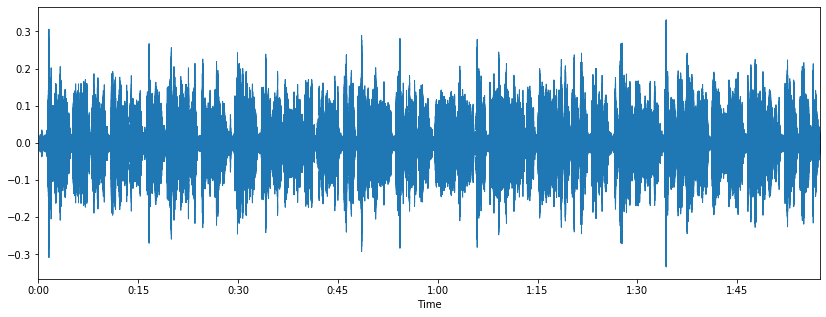

In [9]:
%matplotlib inline
import librosa.display

plt.figure(figsize=(14, 5))
#plotting the sampled signal
librosa.display.waveplot(x, sr= sr)


In [10]:
print(type(x))

<class 'numpy.ndarray'>


Spectrogram : A spectrogram is a visual representation of the spectrum of frequencies of a signal as it varies with time. They are time-frequency portraits of signals. Using a spectrogram, we can see how energy levels (dB) vary over time.


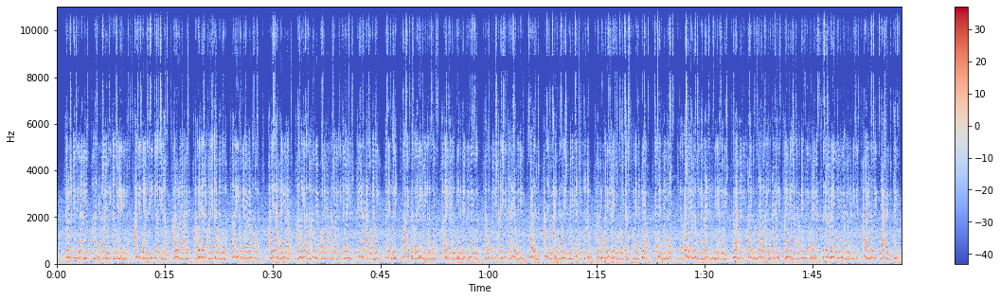

In [11]:
#x: numpy array
X = librosa.stft(x)
#converting into energy levels(dB)
Xdb = librosa.amplitude_to_db(abs(X))

plt.figure(figsize=(20, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()


Log-frequency axis: Features can be obtained from a spectrogram by converting the linear frequency axis, as shown above, into a logarithmic axis. The resulting representation is also called a log-frequency spectrogram.

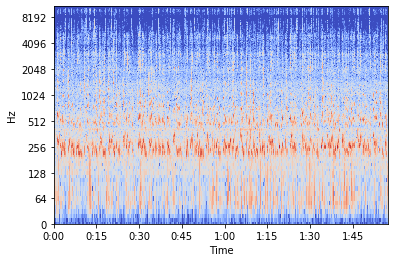

In [12]:
librosa.display.specshow(Xdb, sr=sr, x_axis= 'time', y_axis = 'log')

### Creating an audio signal and saving it

import soundfile as sf

sr = 22050 # sample rate
T = 5.0    # seconds
t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
x = 0.5*np.sin(2*np.pi*220*t)# pure sine wave at 220 Hz

#playing generated audio
ipd.Audio(x, rate=sr) # load a NumPy array

sf.write('generated.wav', x, sr) # writing wave file in .wav format

ipd.Audio('generated.wav', rate = sr)

### Zero crossing rate

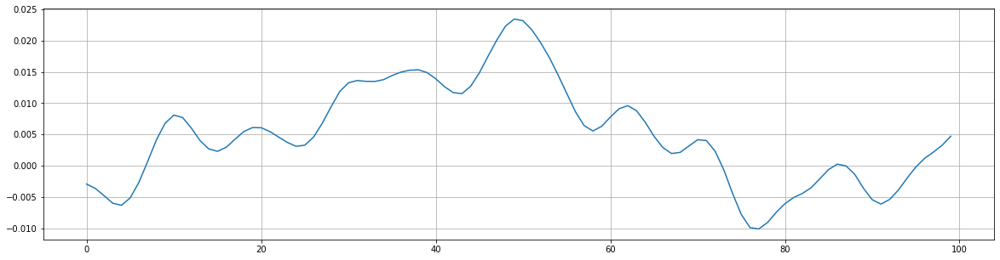

In [13]:
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(20, 5))
plt.plot(x[n0:n1])
plt.grid()

In [14]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
zero_crossings.shape

(100,)

In [15]:
print(sum(zero_crossings))

5


In [16]:
# Do Normalisation 

In [17]:
#spectral_centroids indicates at which frequency the energy of a spectrum is centered upon.
spectral_centroids = librosa.feature.spectral_centroid(x, sr=sr)[0]
spectral_centroids.shape

(5056,)

In [18]:
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)

In [19]:
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

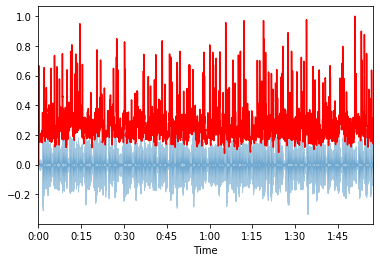

In [20]:
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r') # normalize for visualization purposes

In [21]:
print(x)

[ 0.          0.          0.         ... -0.01050714 -0.00952638
 -0.00964489]


In [23]:
#Importing Pytorch
import torch

#Importing Wav2Vec
from transformers import Wav2Vec2ForCTC, Wav2Vec2Tokenizer

In [24]:
# Importing Wav2Vec pretrained model

tokenizer = Wav2Vec2Tokenizer.from_pretrained("facebook/wav2vec2-base-960h")
model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-base-960h")

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'Wav2Vec2CTCTokenizer'. 
The class this function is called from is 'Wav2Vec2Tokenizer'.
Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [25]:
# Taking an input value

input_values = tokenizer(x, return_tensors = "pt").input_values

In [ ]:
# Storing logits (non-normalized prediction values)
logits = model(input_values).logits

In [ ]:
# Storing predicted ids
prediction = torch.argmax(logits, dim = -1)

In [ ]:
# Passing the prediction to the tokenzer decode to get the transcription
transcription = tokenizer.batch_decode(prediction)[0]

In [ ]:
# Printing the transcription
print(transcription)

In [22]:
# A python package for music and audio analysis.
# https://librosa.org/doc/latest/index.html
import librosa
import torch
from transformers import Wav2Vec2ForCTC, Wav2Vec2Tokenizer

# load model and tokenizer
tokenizer = Wav2Vec2Tokenizer.from_pretrained("facebook/wav2vec2-base-960h")
model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-base-960h")

# The base model pretrained and fine-tuned on 960 hours of Librispeech on 16kHz sampled speech audio.
# When using the model make sure that your speech input is also sampled at 16Khz.

# load any audio file of your choice
collection_of_text = []
for i in range(4):

    speech, rate = librosa.load(f"converted.wav", sr=16000)

    input_values = tokenizer(speech, return_tensors='pt').input_values
    # Store logits (non-normalized predictions)
    with torch.no_grad():
        logits = model(input_values).logits

    # Store predicted id's
    predicted_ids = torch.argmax(logits, dim=-1)
    # decode the audio to generate text
    # Passing the prediction to the tokenzer decode to get the transcription
    transcription = tokenizer.batch_decode(predicted_ids)[0]
    # transcriptions = tokenizer.decode(predicted_ids[0])
    print(transcription)
    collection_of_text.append(transcription)

print(collection_of_text)
final_complete_speech = ""

# convert batch of text into one complete sentence
for i in collection_of_text:
    final_complete_speech += i

print(final_complete_speech)

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'Wav2Vec2CTCTokenizer'. 
The class this function is called from is 'Wav2Vec2Tokenizer'.
Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


HI DONE NOTESON MANEIS TI NE WOMI AN A MA E YEASO A O A IS TO MIN AND THAT ISO MA MYII WASITY AND I WO SAN MANEDIN MEIN OMIISEN I HA I ME I TA GO I A I DIS MA SEE SE E TA ASE MAN  DOSME I N ON TO O A IN DI AN MY TINISMN II OWI TA Y  AN DESANIN OF I A DIS A I WO AND I MOSOINEN I NONET MYNIE TE EDIN O TE MAN TN O MI MOSAS ONOSIN I THE MAY SAY I NOW A A II AN O MY MI ROSIN I NONT TO WANI DAS TAT S A IN A TE GOME E EN OF WAS OFTAN NO MIN  AD TIISTER THAT MY WASME THEY WO MYNIN ANUSION IT WE DII TIS  I DISCOER THAT I MOSOMININ MI SAY NOTO TITIEI OL TE ASKE YOU  WAS A DISCOER THA AN NEEIN TO MEI A TIIN AS OTIN WEASENT I WON ME SAE TO DRI AND  NO NEWTIN THAN WUL HAN TO IN PROVE YTNS FOFOIN I  ALSO WOUD O NIASIAN A MA T DASIONTIS NDN E O T S A WOIN IN OEITIN SO I NO AN TISIN UTION I WANTO SAN OTON WEIS I INI THN TIS OMEN A IION MIN E MY IN EXSADI WATINT TO ON I DO I WANTTE IN PROVE ON MY WOISTI A E SCOSION TWAS PROSINTANINGES O I MAN MEN YOU MES IOS THE SAY ANTO ME IN WIN I MA I O MEFOSOS THEN

In [23]:
import speech_recognition as sr
print(sr.__version__)
r = sr.Recognizer()

file_audio = sr.AudioFile('converted.wav')

with file_audio as source:
    audio_text = r.record(source)

print(type(audio_text))
print(r.recognize_google(audio_text))

3.8.1
<class 'speech_recognition.AudioData'>
hello my name is pretty covid-19 news student at the Vishwakarma University B tech degree in Computer Science I have experience with coding languages list in C plus plus HTML and JavaScript program in Java and it isn't a good understanding of Angular JS and Angular and it was a good job and completed a few web development on contract and the various check I am done and help me that I have done the volunteers and active 14 method of a software development in the Vishwakarma University that I have discovered that their logical thinking
